# **PÉNDULO DOBLE**

En este proyecto modelo estudiaremos la mecánica del péndulo doble, compuesto por dos péndulos simples, como introducción al análisis del caos en sistemas dinámicos. Empecemos por importar las librerías  de Python necesarias.

In [3]:
import numpy as np
from scipy.integrate import odeint
import sympy as sp
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from matplotlib import rc
rc('animation', html='jshtml')

## FORMULACION LAGRANGIANA
En primer lugar, tenemos un sistema de dos partículas puntuales de masas $m_1$ y $m_2$ y cuerdas ideales de longitudes $l_1$ y $l_2$, con movimiento restringido a $\mathbb{R}^2$ y sujeto a las siguientes restricciones:

$$ \vec{r}_1^2-{l_1}^2=0 \\[1em] \vec{r}^2-{l_2}^2=0
$$

Donde tenemos los vectores que definen las posiciones de las partículas:

$$
\vec{r}_1=l_1(sin(\theta_1),-cos(\theta_1)) \\[1em]
\vec{r}=l_2(sin(\theta_2),-cos(\theta_2)) \\[1em]
\vec{r}_2=\vec{r}_1+\vec{r}$$

De esta forma, necesitamos un conjunto de $2 \times 2 -2 = 2$ coordenadas generalizadas. La elección conveniente es $\vec{q}=(\theta_1,\theta_2)$. Programemos la conversión de coordenadas.

In [ ]:
def canonical2cartesian(theta1, theta2, l1, l2):
  x1 = l1 * np.sin(theta1)
  x2 = x1 + l2 * np.sin(theta2)
  y1 = - l1 * np.cos(theta1)
  y2 = y1 - l2 * np.cos(theta2)
  return x1, x2, y1, y2

Para construir el lagrangiano, podremos usar $L=T-V$:

$$
T=\frac{1}{2}\left[m_1({\dot{x}_1}^2+{\dot{y}_1}^2)+
m_2({\dot{x}_2}^2+{\dot{y}_2}^2)\right] \ ; \ V=g(m_1y_1+m_2y_2)
$$

$$
\begin{equation*}
T=\frac{1}{2}\left[
  (m_1+m_2){l_1}^2{\dot{\theta}_1}^2+
  m_2{l_2}^2{\dot{\theta}_2}^2
  \right]+
  m_2l_1l_2\dot{\theta}_1\dot{\theta}_2\cos(\theta_1-\theta_2) \ ; \
  V = -g\left[(m_1+m_2)l_1\cos\theta_1+m_2l_2\cos\theta_2\right]
  \end{equation*}
$$

Obteniendo así:
$$
L(t, \vec{q},\dot{\vec{q}}) =
\frac{1}{2}\left[
  M{l_1}^2{\dot{\theta}_1}^2+
  m_2{l_2}^2{\dot{\theta}_2}^2
  \right]+
  m_2l_1l_2\dot{\theta}_1\dot{\theta}_2\cos(\theta_1-\theta_2)+
  g\left[Ml_1\cos\theta_1+m_2l_2\cos\theta_2\right]
$$

donde $M=m_1+m_2$

## FORMULACION HAMILTONIANA
Si construimos las ecuaciones de Euler-Lagrange, obtendremos un sistema de EDO's de segundo orden. Nuestra intención es obtener un sistema de primer orden, por lo que decidimos utilizar las ecuaciones canónicas de Hamilton. Para ello, primero necesitamos el hamiltoniano, $H(t,\theta_1,\theta_2,p_1,p_2)$. Definimos el momento canónico como $\vec{p}=\frac{\partial L}{\partial \dot{\vec{q}}}$:



$$
\begin{equation*}
p_1=\frac{\partial L}{\partial\dot\theta_1}=
M{l_1}^2\dot{\theta}_1+m_2l_1l_2\dot{\theta}_2\cos(\theta_1-\theta_2) \\[1em]
p_2=\frac{\partial L}{\partial\dot\theta_2}=
m_2{l_2}^2\dot{\theta}_2+m_2l_1l_2\dot{\theta}_1\cos(\theta_1-\theta_2)
\end{equation*}
$$

En forma matricial, esto se puede expresar de la siguiente manera:

$$
\begin{pmatrix}
p_1 \\[.3em] p_2
\end{pmatrix} =
\begin{pmatrix}
M{l_1}^2 & m_2l_1l_2\cos(\theta_1-\theta_2) \\
m_2l_1l_2\cos(\theta_1-\theta_2) & m_2{l_2}^2
\end{pmatrix}
\begin{pmatrix}
\dot{\theta}_1 \\ \dot{\theta}_2
\end{pmatrix}
$$

Invirtiendo la relación, obtenemos:
$$
\begin{pmatrix}
\dot{\theta}_1 \\ \dot{\theta}_2
\end{pmatrix} =
\frac{1}{m_1+m_2\sin^2(\theta_1-\theta_2)}
\begin{pmatrix}
\frac{m_2}{{l_1}^2} & \frac{-m_2\cos(\theta_1-\theta_2)}{l_1l_2} \\
\frac{-m_2\cos(\theta_1-\theta_2)}{l_1l_2} & \frac{M}{{l_2}^2}
\end{pmatrix}
\begin{pmatrix}
p_1 \\[.3em] p_2
\end{pmatrix}
$$

Definimos la función energía:

$$
h(t,\vec{q},\dot{\vec{q}})=\sum_{i=1}^2p_i\dot{q}_i-L = \frac{1}{2}\left[
  M{l_1}^2{\dot{\theta}_1}^2+
  m_2{l_2}^2{\dot{\theta}_2}^2
  \right]+
  m_2l_1l_2\dot{\theta}_1\dot{\theta}_2\cos(\theta_1-\theta_2)-
  g\left[Ml_1\cos\theta_1+m_2l_2\cos\theta_2\right]
$$

  El Hamiltoniano se obtiene a través de la transformación de Legendre $L\rightarrow H \ , \ H = h(t,\vec{q},\dot{\vec{q}}(\vec{p}))$. Al sustituir, y realizar las simplificaciones necesarias obtenemos el Hamiltoniano:
  $$
  H(t,\vec{q},\vec{p})=\frac{m_2{l_2}^2{p_1}^2+M{l_1}^2{p_2}^2}{2m_1{l_1}^2{l_2}^2(m_1+m_2sin^2(\theta_1-\theta_2))}-\frac{cos(\theta_1-\theta_2)p_1p_2}{l_1l_2(m_1+m_2sin^2(\theta_1-\theta_2))}-g\left[Ml_1cos(\theta_1)+m_2l_2cos(\theta_2)\right]
  $$

  Procedamos a obtener las Ecuaciones Canónicas: $\dot{\vec{q}}=\frac{\partial H}{\partial \vec{p}} \ ; \ \dot{\vec{p}}=-\frac{\partial H}{\partial \vec{q}}$. Es así como obtenemos finalmente:

  $$
  \begin{cases}
  \dot{\theta}_1=\frac{p_1}{{l_1}^2(m_1+m_2sin^2(\theta_1-\theta_2))}-\frac{cos(\theta_1-\theta_2)p_2}{l_1l_2(m_1+m_2sin^2(\theta_1-\theta_2))} \\[1em] \dot{\theta}_2=-\frac{cos(\theta_1-\theta_2)p_1}{l_1l_2(m_1+m_2sin^2(\theta_1-\theta_2))}+\frac{Mp_2}{m_2{l_1}^2(m_1+m_2sin^2(\theta_1-\theta_2))}
   \\[1em]
  \dot{p}_1=\frac{m_2{l_2}^2{p_1}^2+M{l_1}^2{p_2}^2-2m_2l_1l_2cos(\theta_1-\theta_2)p_1p_2}{2{l_1}^2{l_2}^2[m_1+m_2sin^2(\theta_1-\theta_2)]^2}sin[2(\theta_1-\theta_2)]-\frac{sin(\theta_1-\theta_2)p_1p_2}{l_1l_2[m_1+m_2sin^2(\theta_1-\theta_2)]}-Mgl_1sin(\theta_1) \\[1em]
  \dot{p}_2=-\frac{m_2{l_2}^2{p_1}^2+M{l_1}^2{p_2}^2-2m_2l_1l_2cos(\theta_1-\theta_2)p_1p_2}{2{l_1}^2{l_2}^2[m_1+m_2sin^2(\theta_1-\theta_2)]^2}sin[2(\theta_1-\theta_2)]+\frac{sin(\theta_1-\theta_2)p_1p_2}{l_1l_2[m_1+m_2sin^2(\theta_1-\theta_2)]}-m_2gl_2sin(\theta_2)
  \end{cases}
  $$

In [ ]:
# Será útil definir el hamiltoniano para estudiar el sistema
# u = [q1, q2, p1, p2]
def H(u, g, m1, m2, l1, l2):
  denom = l1 * l2 * (m1 + m2 * np.sin(q[0] - q[1]) ** 2)
  T1 = (m2 * l2 ** 2 * u[2] ** 2 + (m1 + m2) * l1 ** 2 * u[3] ** 2) / (2 * m1 * l1 * l2 * denom)
  T2 = - np.cos(u[0] - u[1]) * u[2] * u[3] / denom
  V = - g * ((m1 + m2) * l1 * np.cos(u[0]) + m2 * l2 * np.cos(u[1]))
  return T1 + T2 + V

## ECUACIONES DE MOVIMIENTO

Ahora nos queda resolver un sistema de EDOs, lo cual haremos numéricamente. Por conveniencia pondremos nuestras ecuaciones en la siguiente forma:

$$
\dot{\vec{u}}=f(\vec{u})
$$

Donde $\vec{u}$ es un vector que engloba todas las coordenadas que estamos estudiando, $\vec{u}=(\theta_1,\theta_2,p_1,p_2)$, y $f:\mathbb{R}^4\rightarrow\mathbb{R}^4$ representa las ecuaciones a resolver, las cuales hemos deducido arriba. Dado que será conveniente más adelante, vamos a programar $f$ como una función simbólica con SymPy y luego convertirla en numérica.

In [ ]:
# Símbolos
u = sp.IndexedBase('u')
t, g, m1, m2, l1, l2 = sp.symbols('t, g, m_1, m_2, l_1, l_2')

# Ecuaciones
D_theta = u[0] - u[1]
denom = (m1 + m2 * sp.sin(D_theta) ** 2)
d_theta1 = (u[2] / l1 ** 2 - sp.cos(D_theta) * u[3] / (l1 * l2)) / denom
d_theta2 = (- m2 * sp.cos(D_theta) * u[2] / (l1 * l2) + (m1 + m2) * u[3] / l1 ** 2 ) / (m2 * denom)
f1 = (m2*l2**2*u[2]**2+(m1+m2)*l1**2*u[3]**2-2*m2*l1*l2*sp.cos(D_theta))*sp.sin(2*D_theta)/(2*l1**2*l2**2*denom**2)
f2 = sp.sin(D_theta) * u[2] * u[3] / (l1 * l2 * denom)
d_p1 = f1 - f2 - g * (m1 + m2) * l1 * sp.sin(u[0])
d_p2 = - f1 + f2 - g * m2 * l2 * sp.sin(u[1])

# Función simbólica
fsym = sp.Matrix([d_theta1, d_theta2, d_p1, d_p2])
# Función numérica
f = sp.lambdify([u, t, g, m1, m2, l1, l2], fsym.T.tolist()[0])

fsym

Matrix([
[                                                                                                                                                                                  (-cos(u[0] - u[1])*u[3]/(l_1*l_2) + u[2]/l_1**2)/(m_1 + m_2*sin(u[0] - u[1])**2)],
[                                                                                                                                                            (-m_2*cos(u[0] - u[1])*u[2]/(l_1*l_2) + (m_1 + m_2)*u[3]/l_1**2)/(m_2*(m_1 + m_2*sin(u[0] - u[1])**2))],
[-g*l_1*(m_1 + m_2)*sin(u[0]) - sin(u[0] - u[1])*u[2]*u[3]/(l_1*l_2*(m_1 + m_2*sin(u[0] - u[1])**2)) + (l_1**2*(m_1 + m_2)*u[3]**2 - 2*l_1*l_2*m_2*cos(u[0] - u[1]) + l_2**2*m_2*u[2]**2)*sin(2*u[0] - 2*u[1])/(2*l_1**2*l_2**2*(m_1 + m_2*sin(u[0] - u[1])**2)**2)],
[        -g*l_2*m_2*sin(u[1]) + sin(u[0] - u[1])*u[2]*u[3]/(l_1*l_2*(m_1 + m_2*sin(u[0] - u[1])**2)) - (l_1**2*(m_1 + m_2)*u[3]**2 - 2*l_1*l_2*m_2*cos(u[0] - u[1]) + l_2**2*m_2*u[2]**2)*sin(2*u[0] - 2*u[1]

Ya tenemos todos los elementos necesarios para simular el péndulo doble. Solamente requerimos:


*   Unas condiciones iniciales $\vec{u}_0$.
*   Valores de los parámetros $g,m_1,m_2,l_1,l_2$.
*   Un vector de instantes $t$ en los que resolver la EDO.

Integraremos las ecuaciones del movimiento con [scipy.integrate.odeint](https://docs.scipy.org/doc/scipy/reference/generated/scipy.integrate.odeint.html).



In [ ]:
u0 = np.array([1, 1, 2, 3])
g, m1, m2, l1, l2 = 10, 1, 1, 1, 1
dt = .05
t = np.arange(0, 30, dt)

u = odeint(f, u0, t, args=(g, m1, m2, l1, l2))

Obtenemos la solución deseada, pero para entenderla mejor podemos crear una animación del péndulo doble. Para ello usaremos [matplotlib.animation.FuncAnimation](https://matplotlib.org/stable/api/_as_gen/matplotlib.animation.FuncAnimation.html).

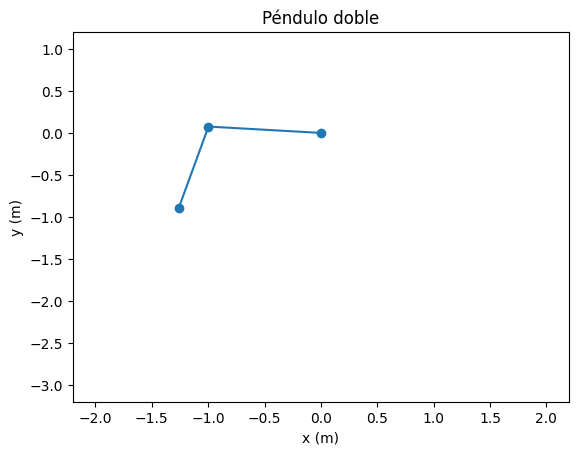

In [ ]:
fig = plt.figure()
pend, = plt.plot([], [], 'o-') # Línea del péndulo a animar
lim = (l1 + l2) * 1.1 # Límites de la figura de la animación
plt.xlim(- lim, lim)
plt.ylim(- lim-1, lim-1)
plt.title('Péndulo doble')
plt.xlabel('x (m)')
plt.ylabel('y (m)')

x1, x2, y1, y2 = canonical2cartesian(u[:, 0], u[:, 1], l1, l2)

def animate(i):
  pend.set_data([0, x1[i], x2[i]], [0, y1[i], y2[i]])
  return pend,

FuncAnimation(fig, animate, frames=len(t), interval=dt*1e3, blit=True)

## CAOS

El péndulo doble es uno de los ejemplos más conocidos a la hora de estudiar el caos en los sistemas dinámicos. Vamos a echarle un primer vistazo, comparando la trayectoria anterior del péndulo con una *pequeña* perturbación de las condiciones iniciales $\vec{v}_0=\vec{u}_0+\Delta\vec{u}_0$.

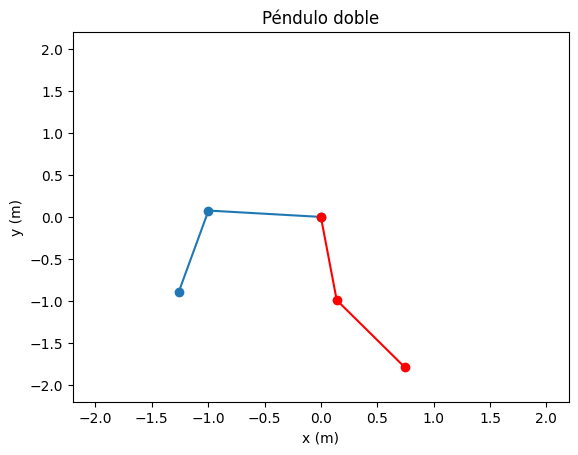

In [ ]:
u0 = np.array([1, 1, 2, 3])
g, m1, m2, l1, l2 = 10, 1, 1, 1, 1
dt = .05
t = np.arange(0, 30, dt)

u = odeint(f, u0, t, args=(g, m1, m2, l1, l2))

# Solución perturbada
D_u0 = 5e-5
v0 = u0 + D_u0
v = odeint(f, v0, t, args=(g, m1, m2, l1, l2))

fig = plt.figure()
pend1, = plt.plot([], [], 'o-', label=r'$\vec{u}_0$')
pend2, = plt.plot([], [], 'ro-', label=r'$\vec{u}_0+\delta \vec{u}_0$')
lim = (l1 + l2) * 1.1
plt.xlim(- lim, lim)
plt.ylim(- lim, lim)
plt.title('Péndulo doble')
plt.xlabel('x (m)')
plt.ylabel('y (m)')
plt.legend('upper right')

xu1, xu2, yu1, yu2 = canonical2cartesian(u[:, 0], u[:, 1], l1, l2)
xv1, xv2, yv1, yv2 = canonical2cartesian(v[:, 0], v[:, 1], l1, l2)

def animate(i):
  pend1.set_data([0, xu1[i], xu2[i]], [0, yu1[i], yu2[i]])
  pend2.set_data([0, xv1[i], xv2[i]], [0, yv1[i], yv2[i]])
  return pend1, pend2

FuncAnimation(fig, animate, frames=len(t), interval=dt*1e3, blit=True)

### EFECTO MARIPOSA

Como podemos observar, la diferencia en las condiciones iniciales es pequeña, pero las trayectorias se separan claramente de forma rápida. Llegamos a una de las características de los sistemas caóticos: la sensibilidad a las condiciones iniciales. Estudiemos el efecto de una pequeña variación $\varepsilon\Delta\vec{u}$, $\varepsilon\ll1$, de la trayectoria $\vec{u}$:

$$
\varepsilon\Delta\dot{\vec{u}}(t)=f(\vec{u}+\varepsilon\Delta\vec{u})-f(\vec{u})=\frac{\partial f}{\partial\vec{u}}\varepsilon\Delta\vec{u}+o(\varepsilon^2)
$$

Queremos estudiar qué pasa cuando $t\rightarrow\infty$. Resulta que $\Delta\vec{u}$ tiende a alinearse con la dirección del espacio propio de $\frac{\partial f}{\partial\vec{u}}$ con mayor autovalor $\lambda$. Es decir, podemos sustituir la ecuación anterior por:

$$
\frac{d}{dt}\Vert\Delta\vec{u}(t)\Vert\sim\lambda\Vert\Delta\vec{u}(t)\Vert
\Rightarrow
\Vert\Delta\vec{u}(t)\Vert\sim e^{\lambda t}\Vert\Delta\vec{u}_0\Vert
$$

¡El efecto es exponencial!

Fuente: en.wikipedia.org/wiki/Lyapunov_exponent
<p align="center">
  <img src="imagenes/LyapunovDiagram.jpg"/>
</p>

En particular, si $\lambda>0$, las trayectorias infinitesimalmente cercanas divergerán. Llamamos a $\lambda$ **exponente de Lyapunov**. En espacios de fase n-dimensionales (el nuestro tiene dimensión 4), se puede estudiar el efecto de perturbaciones en diferentes direcciones, dando lugar a un **espectro de Lyapunov** $\{\lambda_i\}_{i=1}^n$. A efectos prácticos nos interesa solamente el mayor $\lambda$, el cual se obtiene con el límite

$$
\lambda=\lim_{{t\rightarrow\infty\\\Vert\Delta\vec{u}_0\Vert}}\frac{1}{t}\log\frac{\Vert\Delta\vec{u}(t)\Vert}{\Vert\Delta\vec{u}_0\Vert}
$$

Sin embargo, nosotros lo calcularemos por el método presentado por Balcerzak et al. (2018), según a medida que vamos integrando las ecuaciones calculamos $\lambda$ como

$$
\lambda^* = \frac{\Delta\dot{\vec{u}}\cdot\Delta\vec{u}}{\Vert\Delta\vec{u}\Vert^2}
$$

y promediamos todos los valores de $\lambda^*$ que obtengamos. Programémoslo.

In [ ]:
# Media acumulativa, importante para estudiar la evolución de λ(t)
def cummean(x):
  return np.cumsum(x) / range(1, len(x) + 1)

# Máximo exponente de Lyapunov λ(t), viendo cómo evoluciona podremos estudiar su convergencia
def lmax(f, d_f, x0, z0, dt, args, iters=10000):
  x = np.array(x0, dtype='float64') # Variables de estado
  z = np.array(z0, dtype='float64') # Perturbación
  i = 0
  t = 0
  lyap = []
  for _ in range(iters):
    # Renormalización de la perturbación para que no crezca excesivamente
    z = z / np.linalg.norm(z)
    # Integración
    d_x = np.array(f(x, t, *args))
    d_z = np.array(d_f(x, t, *args)) @ z
    lyap.append(d_z.dot(z))
    x += dt * d_x
    z += dt * d_z
    t += dt
  return cummean(lyap)

Text(0, 0.5, '$\\lambda$')

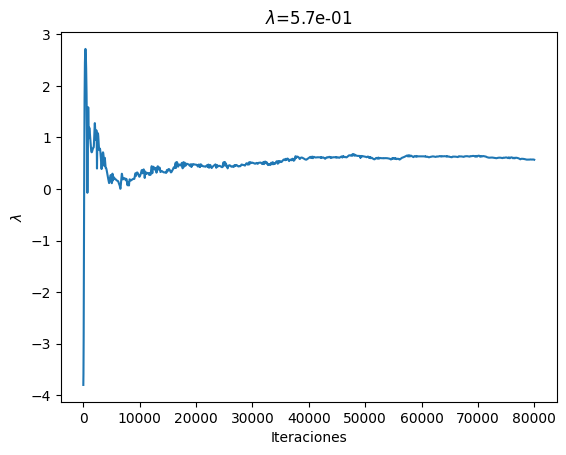

In [ ]:
# Jacobiano de F
u = sp.IndexedBase('u')
t, g, m1, m2, l1, l2 = sp.symbols('t, g, m_1, m_2, l_1, l_2')
J = sp.lambdify([u, t, g, m1, m2, l1, l2], fsym.jacobian([u[0], u[1], u[2], u[3]]))

# Condiciones iniciales que habíamos usado anteriormente
u0 = np.array([1, 1, 2, 3])
z0 = np.ones(4)
dt = .001
g, m1, m2, l1, l2 = 10, 1, 1, 1, 1
args = (g, m1, m2, l1, l2)

l = lmax(f, J, u0, z0, dt, args, iters=80000)
plt.plot(l)
plt.title(f'$\lambda$={l[-1]:.1e}')
plt.xlabel('Iteraciones')
plt.ylabel('$\lambda$')

En efecto, $\lambda>0$, luego las trayectorias divergen como veíamos. Sin embargo, algunas condiciones iniciales son más sensibles a perturbaciones que otras. En particular consideremos la posición de equilibrio $\vec{u}=0$ (péndulo colgando y en reposo) &mdash; se puede demostrar que es estable. Estimemos su exponente de Lyapunov.

Text(0, 0.5, '$\\lambda$')

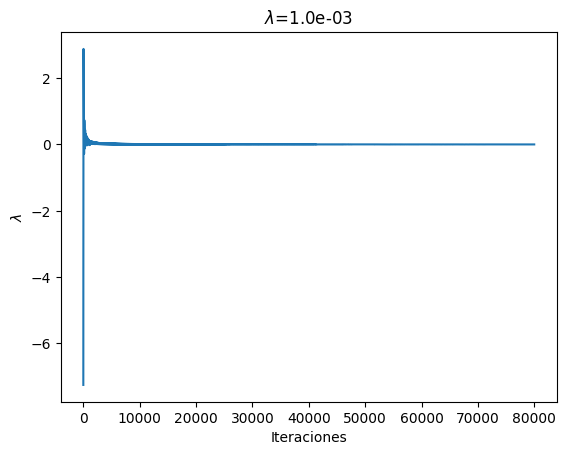

In [ ]:
# Posición de equilibrio
u0 = np.zeros(4)
z0 = np.ones(4)
dt = .01
g, m1, m2, l1, l2 = 10, 1, 1, 1, 1
args = (g, m1, m2, l1, l2)

l = lmax(f, J, u0, z0, dt, args, iters=80000)
plt.plot(l)
plt.title(f'$\lambda$={l[-1]:.1e}')
plt.xlabel('Iteraciones')
plt.ylabel('$\lambda$')

¡Obtenemos $\lambda\approx0$, como cabría esperar! Cuanto más tiempo simulamos estas condiciones iniciales, más se acerca $\lambda$ a $0$. Si soltamos el péndulo doble cerca del equilibrio, simplemente oscila en torno a él.

### OTRAS CONSIDERACIONES
No podemos definir el caos solamente por sensibilidad a las condiciones iniciales. Supongamos que la solución a un sistema es $\vec{u}(t)=e^t\vec{u}_0$. Si perturbamos las condiciones iniciales de una trayectoria $\vec{u}_0+\Delta\vec{u}_0$, entonces la separación entre la trayectoria original y la perturbada será $\Delta\vec{u}(t)=e^t\Delta\vec{u}_0$; sin embargo estas trayectorias no son "caóticas" o "impredecibles".

Se suelen asociar al caos dos condiciones adicionales: transitividad topológica y densidad de órbitas periódicas (para más información, ver Abellán Zapata, 2015). Estas propiedades lo que vienen a decirnos es que las trayectorias se mezclan en el espacio de fases. Como último ejercicio podemos tomar un conjunto de puntos de condiciones iniciales en el espacio de fases y ver cualitativamente cómo evolucionan.

In [ ]:
g, m1, m2, l1, l2 = 10, 1, 1, 1, 1
dt = .1
t = np.arange(0, 10, dt)

# Mapa de flujo de los puntos, vectorizamos la integración de la EDO para aplicarla a muchos puntos
Phit = np.vectorize(lambda u0: odeint(f, u0, t, args=(g, m1, m2, l1, l2), Dfun=J), signature=f'(4)->({len(t)},4)')

In [ ]:
# Generamos una red de ≤N puntos en un cubo dim-dimensional, lado=l
def cubo(l, dim, N):
  n = int(N ** (1 / dim))
  x = np.linspace(- l / 2, l / 2, n)
  g = np.meshgrid(*np.tile(x, [dim, 1]))
  puntos = np.vstack(tuple(map(np.ravel, g))).T
  return puntos

U0 = cubo(2, 4, 256)
U = Phit(U0)
theta_1 = U[:, :, 0]
theta_2 = U[:, :, 1]
p_1 = U[:, :, 2]
p_2 = U[:, :, 3]

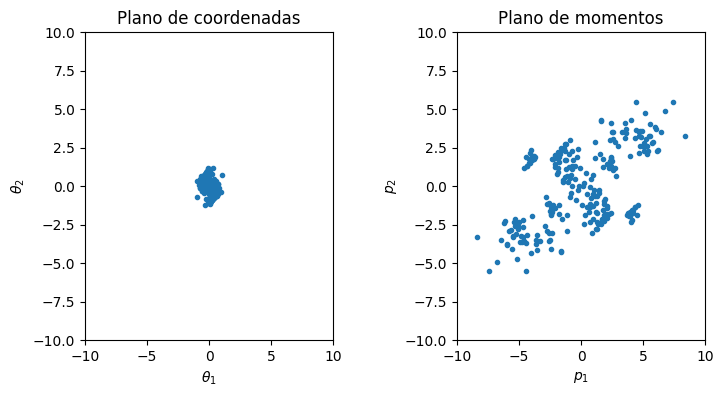

In [ ]:
# Vemos proyecciones del espacio de fases en los planos θ1, θ2 y p1, p2
fig, (axt, axp) = plt.subplots(1, 2, figsize=(8, 4))
plt.subplots_adjust(wspace=.5)
ballt, = axt.plot([], [], '.')
ballp, = axp.plot([], [], '.')
lim = 10
axt.set_xlim(- lim, lim)
axt.set_ylim(- lim, lim)
axt.set_title('Plano de coordenadas')
axt.set_xlabel(r'$\theta_1$')
axt.set_ylabel(r'$\theta_2$')
axp.set_xlim(- lim, lim)
axp.set_ylim(- lim, lim)
axp.set_title('Plano de momentos')
axp.set_xlabel(r'$p_1$')
axp.set_ylabel(r'$p_2$')

def animate(i):
  ballt.set_data(theta_1[:, i], theta_2[:, i])
  ballp.set_data(p_1[:, i], p_2[:, i])
  return ballt, ballp

FuncAnimation(fig, animate, frames=len(t), interval=dt*1e3, blit=True)

## BIBLIOGRAFÍA

1.   Lyapunov exponent: https://en.wikipedia.org/wiki/Lyapunov_exponent
1.   Balcerzak, M., Pikunov, D. & Dabrowski, A. The fastest, simplified method of Lyapunov exponents spectrum estimation for continuous-time dynamical systems. Nonlinear Dyn 94, 3053–3065 (2018). https://doi.org/10.1007/s11071-018-4544-z
1. Abellán Zapata, V. (2015). Caos, linealidad y dimensión. Universidad de Murcia.
